# Hierarchical Clustering

### Data Mining Project 2024/25

Authors: Nicola Emmolo, Simone Marzeddu, Jacopo Raffi

This notebook study the application of the Hierarchical clustering algorithm on races data.

The approach below includes in the clustering process the 6 features `points`, `length`, `climb_total`, `race_physical_effort`, `race_prestige` and `num_participants`.

The selection of these features was derived from a data understanding process, applied following the data cleaning and feature engeneering phases, through which it was possible to skim the attributes by identifying those that appeared to be the most significant. In particular, thanks to the data representation process (applying UMAP and PCA) these feature emerged as the most "aligned" with the principal components.

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram, cophenet
from sklearn.preprocessing import StandardScaler

import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
import numpy as np
from scipy.cluster.hierarchy import fcluster

import itertools

import warnings
warnings.filterwarnings('ignore')

In [3]:
def plot_variable_pairs(columns_to_use, dataset):
    # Creazione di tutte le combinazioni di coppie di variabili
    pairs = list(itertools.combinations(columns_to_use, 2))
    n_pairs = len(pairs)

    # Dimensione della griglia (calcolata in base al numero di coppie)
    n_cols = 2  # Numero di colonne nella griglia
    n_rows = int(np.ceil(n_pairs / n_cols))  # Numero di righe nella griglia

    # Creazione della griglia di subplot
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(10, 5 * n_rows))

    # Se c'è una sola riga di subplot, axes sarà un array 1D; uniformiamo la struttura.
    if n_rows == 1:
        axes = axes[np.newaxis, :]

    # Plot per ogni coppia di variabili
    for (x_var, y_var), ax in zip(pairs, axes.ravel()):
        sns.scatterplot(
            data=dataset,
            x=x_var, y=y_var, hue="cluster", palette="viridis", ax=ax, s=10
        )
        ax.set_title(f'Clusters: {x_var} vs {y_var}')
        ax.legend()

    # Rimuovi subplot vuoti se n_pairs non riempie la griglia
    for ax in axes.ravel()[n_pairs:]:
        fig.delaxes(ax)

    plt.tight_layout()
    plt.show()

In [4]:
def plot_variable_triplets(columns_to_use, dataset):
    # Creazione di tutte le combinazioni di triplette di variabili
    triplets = list(itertools.combinations(columns_to_use, 3))
    n_triplets = len(triplets)

    # Dimensione della griglia (calcolata in base al numero di triplette)
    n_cols = 2  # Numero di colonne nella griglia
    n_rows = int(np.ceil(n_triplets / n_cols))  # Numero di righe nella griglia

    # Creazione della griglia di subplot
    fig = plt.figure(figsize=(14, 7 * n_rows))


    # Plot per ogni combinazione di tre variabili
    for i, (x_var, y_var, z_var) in enumerate(triplets):
        ax = fig.add_subplot(n_rows, n_cols, i + 1, projection='3d')

        # Scatterplot dei dati
        ax.scatter(
            dataset[x_var],
            dataset[y_var],
            dataset[z_var],
            c=dataset["cluster"], cmap="viridis", s=10, zorder=1
        )

        # Titolo e etichette
        ax.set_title(f'Clusters: {x_var} vs {y_var} vs {z_var}', pad=20)
        ax.set_xlabel(x_var)
        ax.set_ylabel(y_var)
        ax.set_zlabel(z_var)

    # Imposta layout per evitare sovrapposizioni
    plt.tight_layout()
    plt.show()

In [5]:
races_dataset = pd.read_csv('../../data/races_dataset_no_outliers.csv').drop(['uci_points', 'profile'], axis=1)
races_dataset = races_dataset.select_dtypes(include=['number'])
races_dataset = races_dataset.dropna().reset_index(drop=True)

# drop colums from PCA and UMAP analisis
races_dataset = races_dataset.drop(['startlist_quality', 'race_year', 'climb_percentage'], axis=1)

races_dataset.info()
columns_to_use = races_dataset.columns

# Standardizzazione dei dati
scaler = StandardScaler()
data_scaled = scaler.fit_transform(races_dataset)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2841 entries, 0 to 2840
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   points                2841 non-null   float64
 1   length                2841 non-null   float64
 2   climb_total           2841 non-null   float64
 3   race_physical_effort  2841 non-null   float64
 4   race_prestige         2841 non-null   float64
 5   num_participants      2841 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 133.3 KB


## Complete

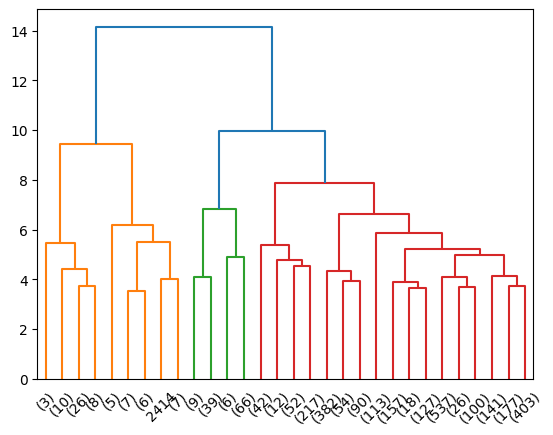

In [6]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='complete', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

Imbalanced dendogram

In [7]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.7806861322044526)

In [8]:
cluster_labels = fcluster(data_link, t=7, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.32622832760674203)

### 2D

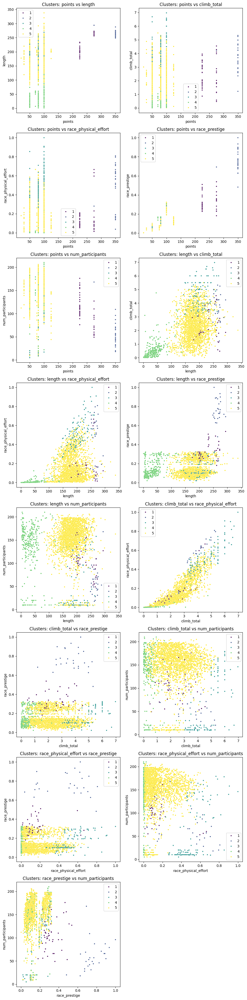

In [9]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

### 3D

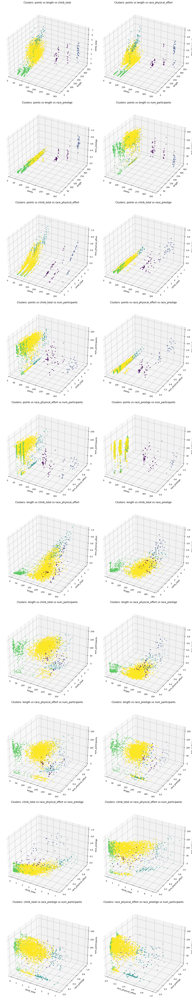

In [10]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

- Viola 1 - points (medio alti)
- Blu 2 - race_prestige, points (alti)
- Celeste 3 - race_prestige, points (bassi) + race_physical_effort (tendenzialmente alto)
- Verde 4 -  length, race_prestige (bassi)
- Giallo 5 - race_prestige, points (bassi) + race_physical_effort (medio basso)

## Single

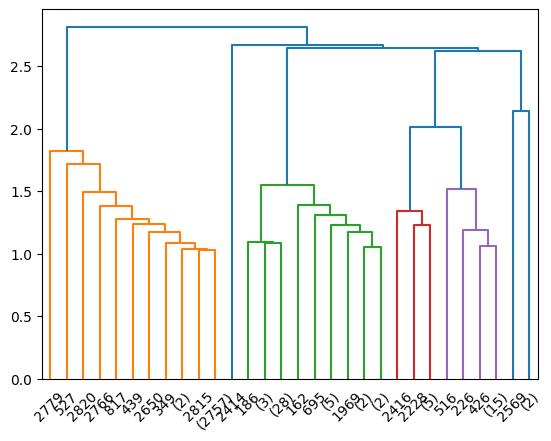

In [11]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='single', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [12]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.6730426544087956)

In [13]:
cluster_labels = fcluster(data_link, t=2.3, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.46297241549494794)

### 2D

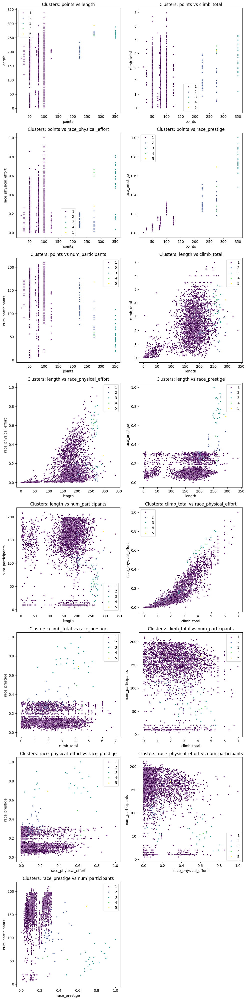

In [14]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

Clustering peggiore rispetto al metodo "complete". Un cluster contiene un solo punto (può darsi che sia dovuto a outlier).

Il cluster viola rappresenta alto prestigio e alto physical_effort, il cluster verde sostanzialmente tutto il resto.

### 3D

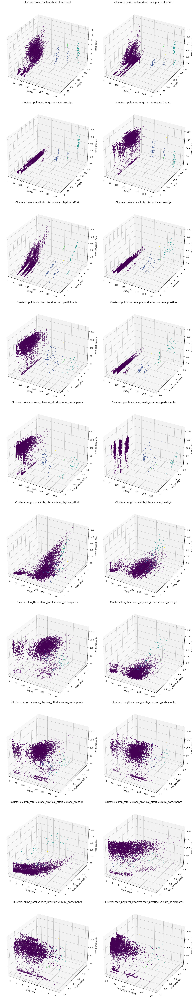

In [15]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

Viola 1 - points (bassi)
Blu 2 - points (medi), race_physical_effort (basso)
Celeste 3 - points (alti), race_prestige (alto)
Verde 4 -  points (medi), race_physical_effort (alto)
Giallo 5 - points (medi), race_physical_effort (medio), race_prestige (alto)

## Average

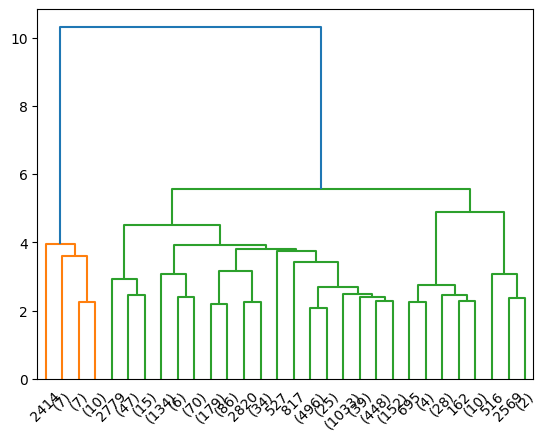

In [16]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='average', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [17]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.8638198806214112)

In [18]:
cluster_labels = fcluster(data_link, t=5, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.48866917159252965)

### 2D

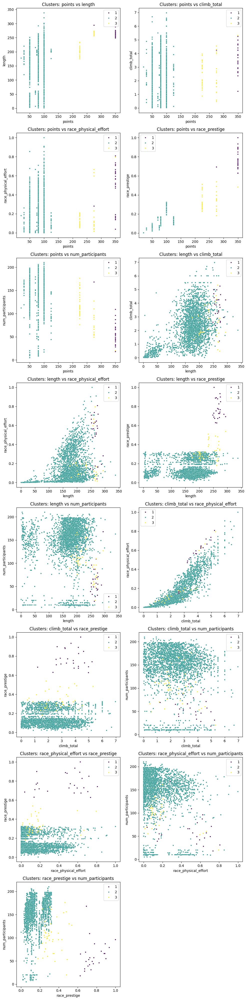

In [19]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

Metodo "Average" sembra più preciso rispetto ai due precedenti.

- Cluster viola -> basso prestigio, poca lunghezza e poco physical_effort;
- Cluster giallo -> medio-alto prestigio e molta lunghezza ma poco sforzo fisico;
- Cluster verde -> Gare molto impegnative molto lunghe, richiedono molto sforzo fisico e hanno anche un elevato prestigio;
- Cluster blu chiaro -> gare impegnative a medio-basso prestigio ma allo stesso tempo brevi;
- Cluster blu scuro -> gare a basso prestigio (lunghezza media e sforzo fisico variabile).

### 3D

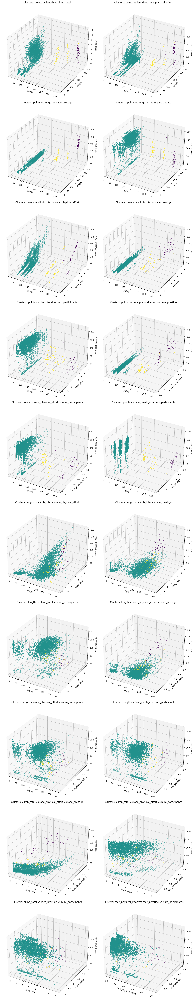

In [20]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

Viola 1 - points (alto), race_prestige (alto)
Celeste 2 - points (bassi), race_prestige (bassi)
Giallo 3 - points (medi)

## Ward

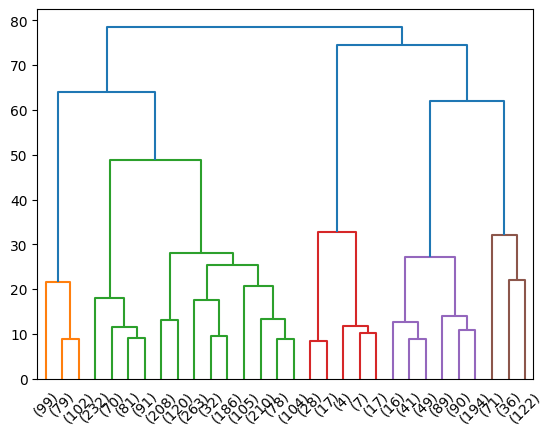

In [21]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='ward', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [22]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.5952483644680285)

In [23]:
cluster_labels = fcluster(data_link, t=55, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.3144409681372585)

### 2D

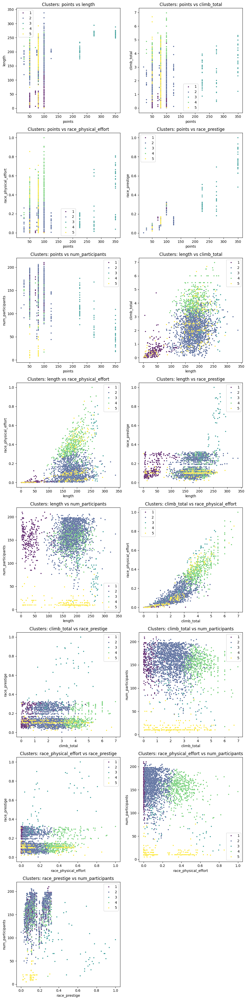

In [24]:
races_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, races_dataset)

- Cluster giallo -> gare lunghe e ad alto prestigio con sforzo fisico variabile;
- Cluster viola -> gare brevi e semplici con basso prestigio;
- Cluster blu -> gare con basso prestigio e lunghezza media ma che richiedono un notevole sforzo fisico;
- Cluster verde -> gare di lunghezza media alta ma con poco prestigio e poco sforzo fisico.

### 3D

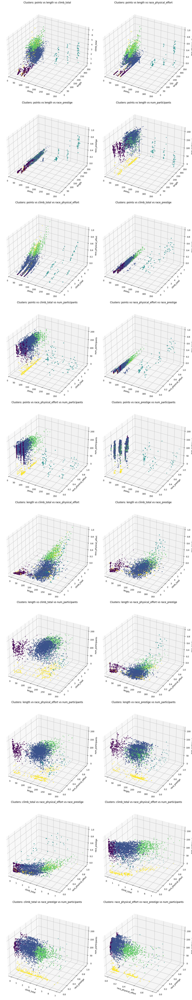

In [25]:
races_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, races_dataset)

Viola 1 - lenght (bassi) num_partecipants (medio alto)
Blu 2 - lenght (media) num_partecipants (medio alto), climb_total (medio basso)
Celeste 3 - points (alti)
Verde 4 -  lenght (media) num_partecipants (medio alto) + climb_total (medio alto)
Giallo 5 - num_partecipants (bassi)